<a href="https://colab.research.google.com/github/23subbhashit/VR-ASSIGNMENTS/blob/main/VR_ASSIGNMENT_1B.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


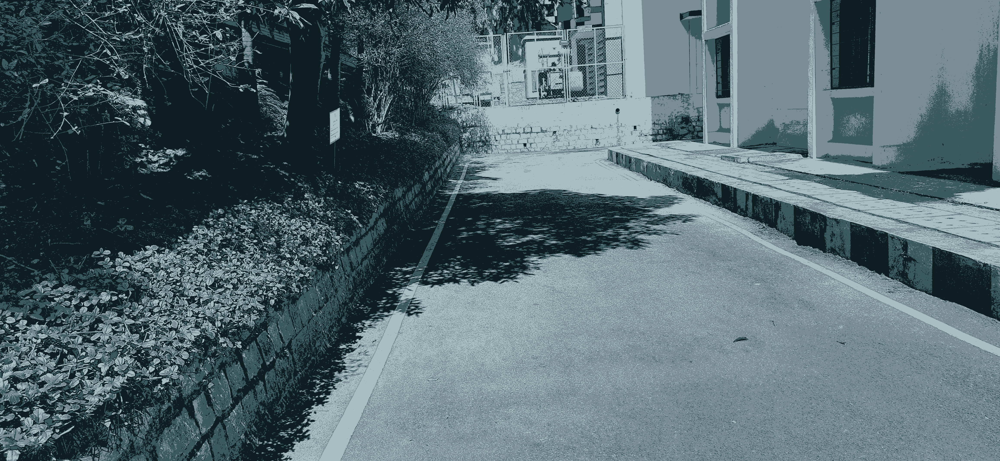

In [ ]:
# K-MEANS
import cv2
import numpy as np
from sklearn.cluster import KMeans
from google.colab.patches import cv2_imshow

def remove_shadows_kmeans(image_path, num_clusters=4):
    # Read the image
    image = cv2.imread(image_path)

    # Reshape the image to a 2D array of pixels (rows * columns, channels)
    pixels = image.reshape((-1, 3))

    # Convert the data type to floating-point
    pixels = np.float32(pixels)

    # Apply k-means clustering
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(pixels)

    # Get the cluster centers and labels
    centers = np.uint8(kmeans.cluster_centers_)
    labels = kmeans.labels_

    # Assign each pixel the color of its cluster center
    segmented_image = centers[labels].reshape(image.shape)

    # # Display the original and segmented images
    # cv2_imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    cv2_imshow(cv2.cvtColor(segmented_image, cv2.COLOR_BGR2RGB))

    return segmented_image

# Example usage
image_path = '/content/ShadowRemoval1.jpg'
segmented_image = remove_shadows_kmeans(image_path)


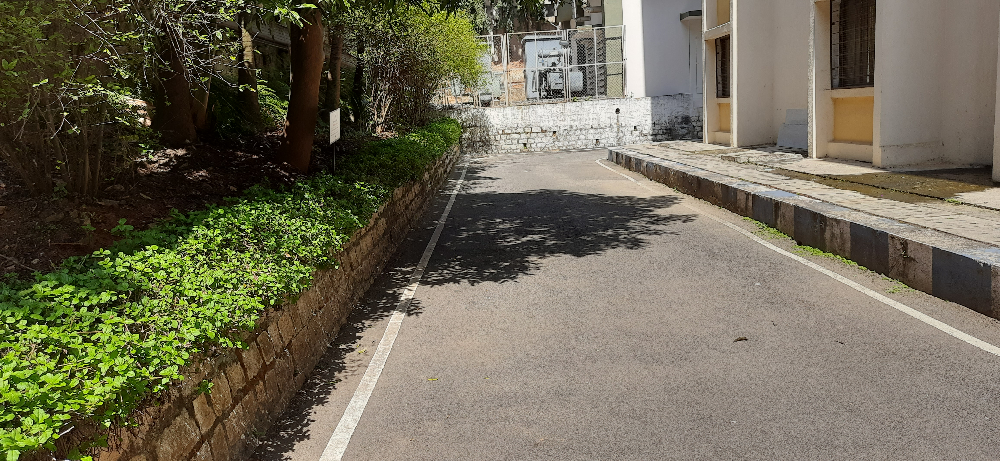

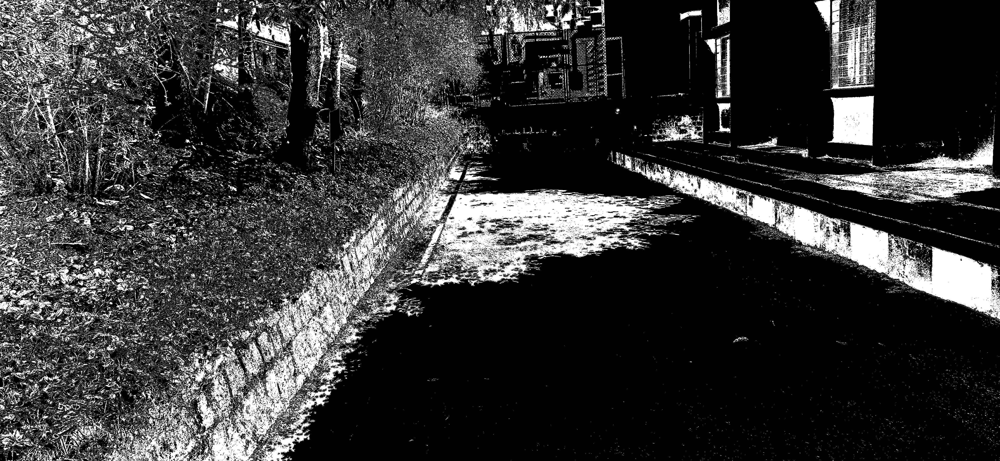

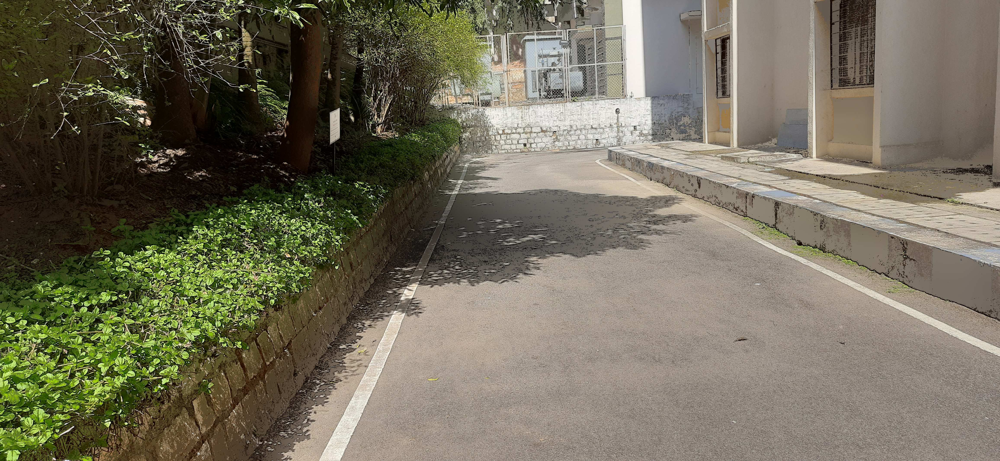

In [87]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from tqdm import tqdm

def remove_shadows_rgb(image_path, luminance_thresholds=((0, 15), (45, 65)), neighborhood_size=1000):
    # Read the image
    image = cv2.imread(image_path)

    # Extract the R channel (red) from RGB
    red_channel = image[:, :, 0]

    # Create a binary mask for shadows based on the luminance thresholds
    shadow_mask = np.zeros_like(red_channel, dtype=np.uint8)
    for lower, upper in luminance_thresholds:
        shadow_mask |= ((red_channel > lower) & (red_channel < upper)).astype(np.uint8) * 255

    # Invert the shadow mask
    non_shadow_mask = cv2.bitwise_not(shadow_mask)

    # Extract the neighborhood around each non-shadow pixel
    neighborhood = cv2.boxFilter(image, -1, (neighborhood_size, neighborhood_size))

    # Calculate the average color of the neighborhood for each non-shadow pixel
    average_colors = neighborhood / cv2.boxFilter(np.ones_like(image), -1, (neighborhood_size, neighborhood_size))

    # Replace the shadow regions with the calculated average colors
    result_image = np.where(shadow_mask[..., None], average_colors, image)

    # Display the original image, shadow mask, and the image with removed shadows
    cv2_imshow(image)
    cv2_imshow(shadow_mask)
    cv2_imshow(result_image.astype(np.uint8))

# Example usage with tqdm
image_path = '/content/ShadowRemoval1.jpg'
remove_shadows_rgb(image_path, luminance_thresholds=((11, 15), (23, 69)), neighborhood_size=500)
